In [2]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import netCDF4 as nc
import matplotlib.pyplot as plt
import numpy as np
import copy
import os
import glob
import pylab as pl
import numpy as np
import matplotlib.animation as animation
import types
from mpl_toolkits.basemap import cm,addcyclic,Basemap, shiftgrid
import matplotlib.patches as patches
% matplotlib inline

# ENG3-ENG4 2007-2008

In [3]:
nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/min_ice/nasaRun/Y*2008*.nc'))#*_ptrc_T*.nc'))
print("found *.nc file: \n{}".format(nc_filename))
ptrc=nc.Dataset(nc_filename[0])

uvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG4_gridU_20072009.nc')
print uvel.variables

vvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG4_gridV_20072009.nc')
print vvel.variables

wvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG4_gridW_20072009.nc')
print wvel.variables


uvel1969=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridU_19692008.nc')

vvel1969=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridV_19692008.nc')

wvel1969=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridW_19692008.nc')

found *.nc file: 
['/ocean/xiaoxiny/research/result_jasper/min_ice/nasaRun/Y19682008.nc']
OrderedDict([(u'nav_lon', <netCDF4.Variable object at 0x7feea2f5f180>), (u'nav_lat', <netCDF4.Variable object at 0x7feea2f5f218>), (u'depthu', <netCDF4.Variable object at 0x7feea2f5f2b0>), (u'time_counter', <netCDF4.Variable object at 0x7feea2f5f348>), (u'vozocrtx', <netCDF4.Variable object at 0x7feea2f5f3e0>), (u'sozotaux', <netCDF4.Variable object at 0x7feea2f5f478>)])
OrderedDict([(u'nav_lon', <netCDF4.Variable object at 0x7feea2f5f5a8>), (u'nav_lat', <netCDF4.Variable object at 0x7feea2f5f640>), (u'depthv', <netCDF4.Variable object at 0x7feea2f5f6d8>), (u'time_counter', <netCDF4.Variable object at 0x7feea2f5f770>), (u'vomecrty', <netCDF4.Variable object at 0x7feea2f5f808>), (u'sometauy', <netCDF4.Variable object at 0x7feea2f5f8a0>)])
OrderedDict([(u'nav_lon', <netCDF4.Variable object at 0x7feea2f5f9d0>), (u'nav_lat', <netCDF4.Variable object at 0x7feea2f5fa68>), (u'depthw', <netCDF4.Variable o

In [4]:
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
dep = ptrc.variables['deptht'][:]


tmask=nc.Dataset(
        '/ocean/xiaoxiny/research/data/mesh_mask_anha4_201509.nc')
mbathy=tmask.variables['mbathy'][0,400:,:]
tmask=tmask.variables['tmask'][0,:,400:,:]


bathy=nc.Dataset(
    '/ocean/xiaoxiny/research/data/Jasper/ANHA4_bathy_etopo1_gebco1_smoothed_coast_corrected_mar10.nc')
bathy=bathy.variables['Bathymetry'][400:,:]

In [5]:
yearnum=2

In [6]:
datein=20072009
print '/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG4_gridU_%s.nc'%datein

/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG4_gridU_20072009.nc


In [17]:
def vel(keyword,time,ENG,datein):
    'design to obtain velocity field'
    if keyword =='U':
        uvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG%s_gridU_%s.nc'%(ENG,datein))
        data =uvel.variables['vozocrtx'][time,:,400:,:]
    elif keyword =='V':
        vvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG%s_gridV_%s.nc'%(ENG,datein))
        data =vvel.variables['vomecrty'][time,:,400:,:]
    else:
        wvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG%s_gridW_%s.nc'%(ENG,datein))
        data =wvel.variables['vovecrtz'][time,:,400:,:]
    data =np.ma.masked_where(tmask==0,data)
    return data

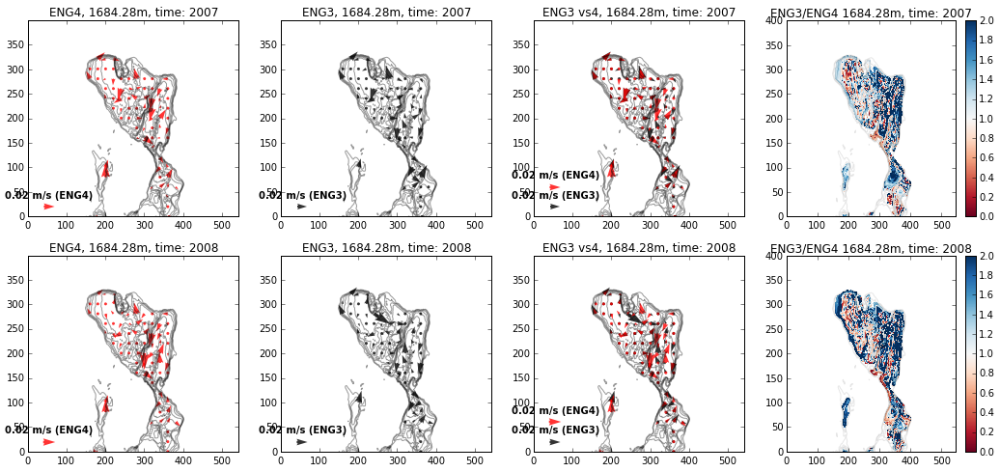

In [75]:
layer=38
k=0
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
x1d=np.linspace(0,lon[:,0].shape[0],lon[:,0].shape[0])
y1d=np.linspace(0,lon[0,:].shape[0],lon[0,:].shape[0])
x2d,y2d=np.meshgrid(y1d,x1d)

fig = plt.figure(figsize=(18,8))
for i in range (yearnum):
    time =i
    
    ax = fig.add_subplot(2,4,4*k+1)

    x_lon,y_lat = lon,lat
    u =vel('U',time,4,20072009)
    v =vel('V',time,4,20072009)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    v =np.ma.masked_where(abs(v)>0.03,v)
    Q=plt.quiver(x2d[::20,::20], y2d[::20,::20], u[layer,::20,::20], v[layer,::20,::20],
               width=0.015,color='red',alpha=0.8)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s (ENG4)',fontproperties={'weight': 'bold'})
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('ENG4, %sm, time: %s'%(dep[layer],2007+i))
    
    ax = fig.add_subplot(2,4,4*k+2)
    uENG3 =vel('U',time-2,3,19692008)
    vENG3 =vel('V',time-2,3,19692008)
    #mask too large value
    uENG3 =np.ma.masked_where(abs(vENG3)>0.03,uENG3)
    vENG3 =np.ma.masked_where(abs(vENG3)>0.03,vENG3)
    Q=plt.quiver(x2d[::20,::20], y2d[::20,::20], uENG3[layer,::20,::20], vENG3[layer,::20,::20],
               width=0.015,alpha=0.8)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s (ENG3)',fontproperties={'weight': 'bold'})
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('ENG3, %sm, time: %s'%(dep[layer],2007+i))
 
    ax = fig.add_subplot(2,4,4*k+3)
    
    Q=plt.quiver(x2d[::20,::20], y2d[::20,::20], uENG3[layer,::20,::20], vENG3[layer,::20,::20],
               width=0.015,alpha=0.8)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s (ENG3)',fontproperties={'weight': 'bold'})
    Q=plt.quiver(x2d[::20,::20], y2d[::20,::20], u[layer,::20,::20], v[layer,::20,::20],
               width=0.015,color='red',alpha=0.8)    
    Qlabel=plt.quiverkey(Q,0.1, 0.15, 0.02, '0.02 m/s (ENG4)',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('ENG3 vs4, %sm, time: %s'%(dep[layer],2007+i))
    
    
    ax = fig.add_subplot(2,4,4*k+4)
    diff=(uENG3[layer,:,:]**2+ vENG3[layer,:,:]**2)**0.5/(u[layer,:,:]**2+ v[layer,:,:]**2)**0.5
    plt.pcolor(x2d[:,:], y2d[:,:], diff,cmap='RdBu',vmin=0,vmax=2)
    plt.colorbar()
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.1)

    plt.title('ENG3/ENG4 %sm, time: %s'%(dep[layer],2007+i))
    
    
    k+=1

plt.show()

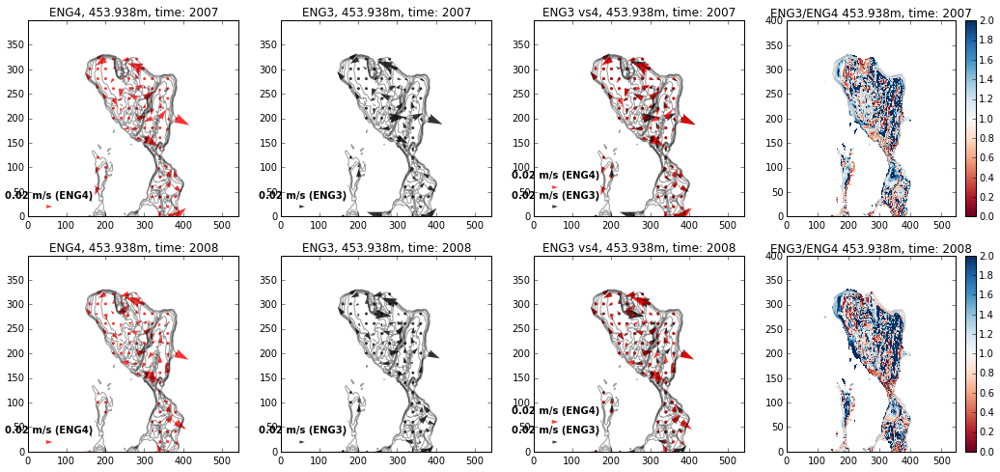

In [78]:
#layer 30

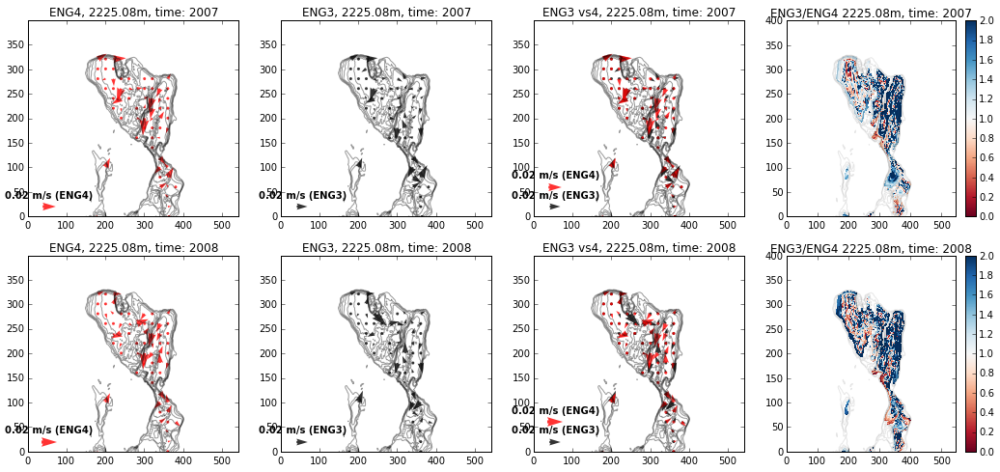

In [79]:
# layer 40

1 ==> the same

2 ==> ENG3 is twice of ENG4

0.5 ==> ENG4 is half of ENG3

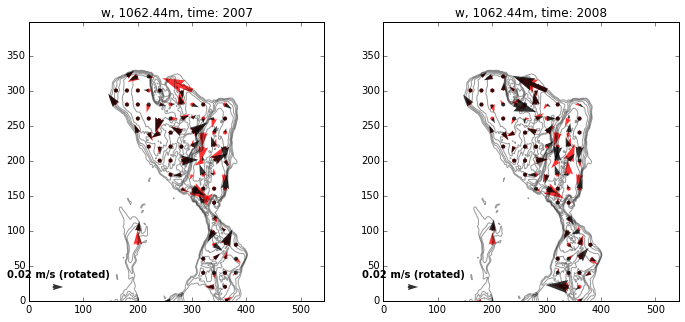

In [26]:
layer=35
k=0
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
x1d=np.linspace(0,lon[:,0].shape[0],lon[:,0].shape[0])
y1d=np.linspace(0,lon[0,:].shape[0],lon[0,:].shape[0])
x2d,y2d=np.meshgrid(y1d,x1d)

fig = plt.figure(figsize=(18,5))
for i in range (yearnum):
    time =i
    k+=1
    
    ax = fig.add_subplot(1,3,k)

    x_lon,y_lat = lon,lat
    u =vel('U',time,4,20072009)
    v =vel('V',time,4,20072009)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    v =np.ma.masked_where(abs(v)>0.03,v)
    Q=plt.quiver(x2d[::20,::20], y2d[::20,::20], u[layer,::20,::20], v[layer,::20,::20],
               width=0.015,color='red',alpha=0.8)
    
    u =vel('U',time-2,3,19692008)
    v =vel('V',time-2,3,19692008)
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    v =np.ma.masked_where(abs(v)>0.03,v)
    Q=plt.quiver(x2d[::20,::20], y2d[::20,::20], u[layer,::20,::20], v[layer,::20,::20],
               width=0.015,alpha=0.8)



    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s',fontproperties={'weight': 'bold'}) #x(0-1),y(0-1), scale, label, position

    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)

    plt.title('w, %sm, time: %s'%(dep[layer],2007+i))

plt.show()

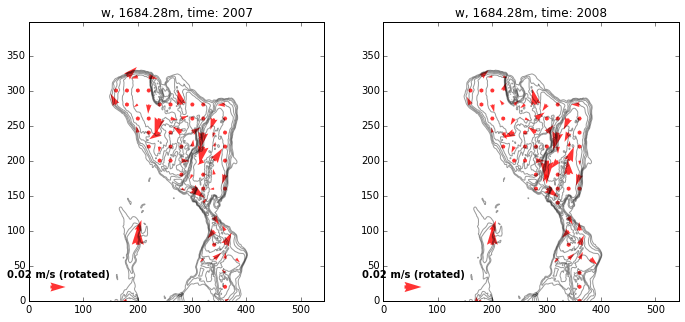

In [27]:
#Eng4

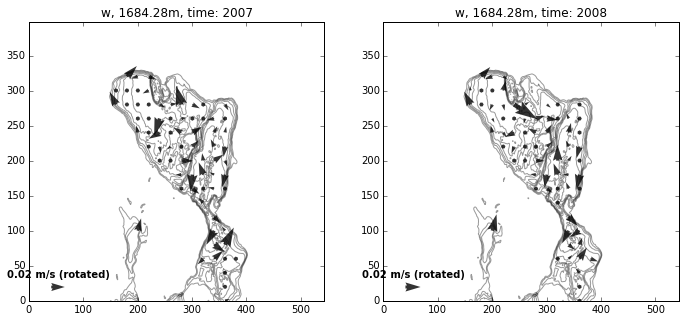

In [28]:
#ENG3

In [7]:
x1d=np.linspace(0,lon[:,0].shape[0],lon[:,0].shape[0])
y1d=np.linspace(0,lon[0,:].shape[0],lon[0,:].shape[0])
x2d,y2d=np.meshgrid(y1d,x1d)



#mask too large value
#u =np.ma.masked_where(abs(v)>0.03,u)
#v =np.ma.masked_where(abs(v)>0.03,v)


In [8]:
def vel(keyword,T,ENG):
    'design to obtain velocity field'
    if keyword =='U':
        nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/data_eng3/*%s*U*%s*.nc'%(ENG,T)))
        uvel=nc.Dataset(nc_filename[0])
        data =uvel.variables['vozocrtx'][0,:,400:,:]
    elif keyword =='V':
        nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/data_eng3/*%s*V*%s*.nc'%(ENG,T)))
        vvel=nc.Dataset(nc_filename[0])
        data =vvel.variables['vomecrty'][0,:,400:,:]
    else:
        nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/data_eng3/*%s*W*%s*.nc'%(ENG,T)))
        wvel=nc.Dataset(nc_filename[0])
        data =wvel.variables['vovecrtz'][0,:,400:,:]
    data =np.ma.masked_where(tmask==0,data)
    return data

In [9]:
layer=38
k=0
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
x1d=np.linspace(0,lon[:,0].shape[0],lon[:,0].shape[0])
y1d=np.linspace(0,lon[0,:].shape[0],lon[0,:].shape[0])
x2d,y2d=np.meshgrid(y1d,x1d)

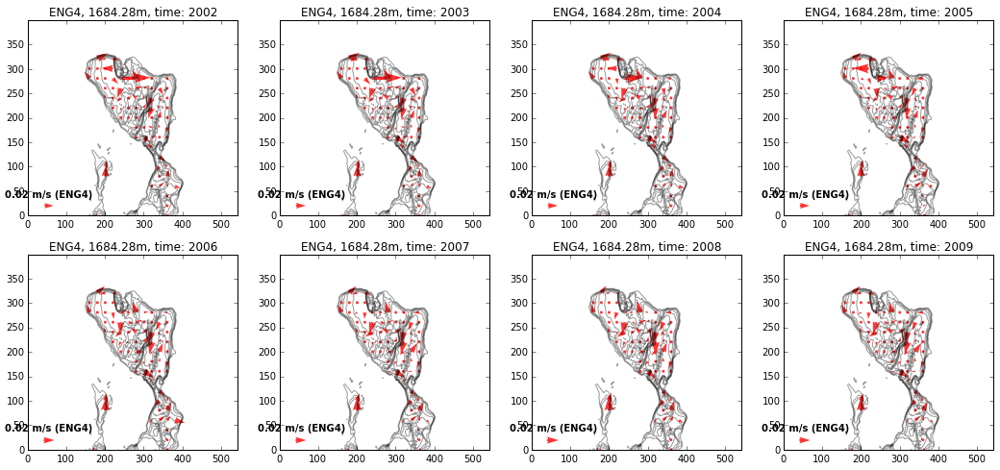

In [19]:
yearnum=8
fig = plt.figure(figsize=(18,8))
k=0
for i in range (yearnum):
    time =i
    
    ax = fig.add_subplot(2,4,k+1)
    x_lon,y_lat = lon,lat
    u =vel('U',time+2002,'ENG4')
    v =vel('V',time+2002,'ENG4')
    #mask too large value
    u =np.ma.masked_where(abs(v)>0.03,u)
    v =np.ma.masked_where(abs(v)>0.03,v)
    Q=plt.quiver(x2d[::20,::20], y2d[::20,::20], u[layer,::20,::20], v[layer,::20,::20],
               width=0.015,color='red',alpha=0.8)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s (ENG4)',fontproperties={'weight': 'bold'})
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('ENG4, %sm, time: %s'%(dep[layer],2002+i))
    k+=1

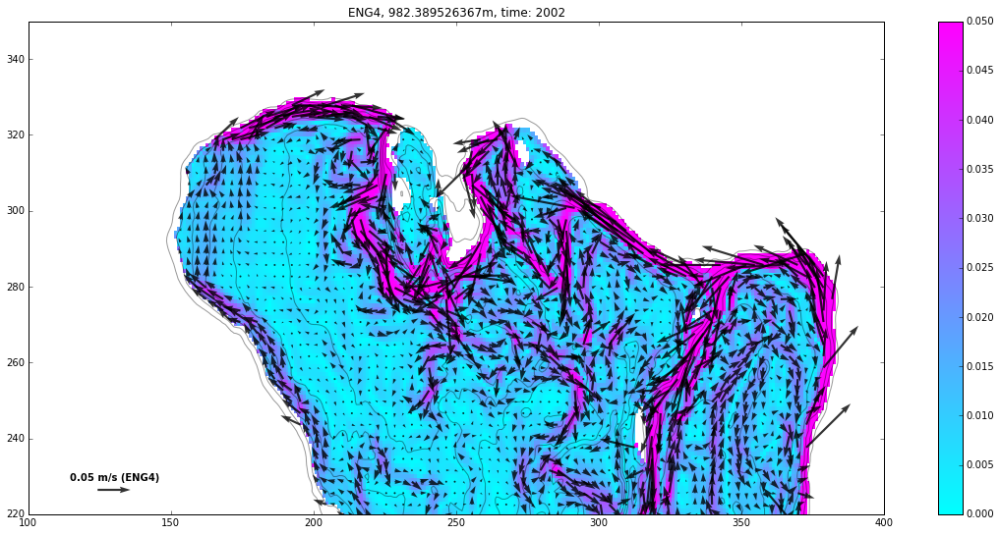

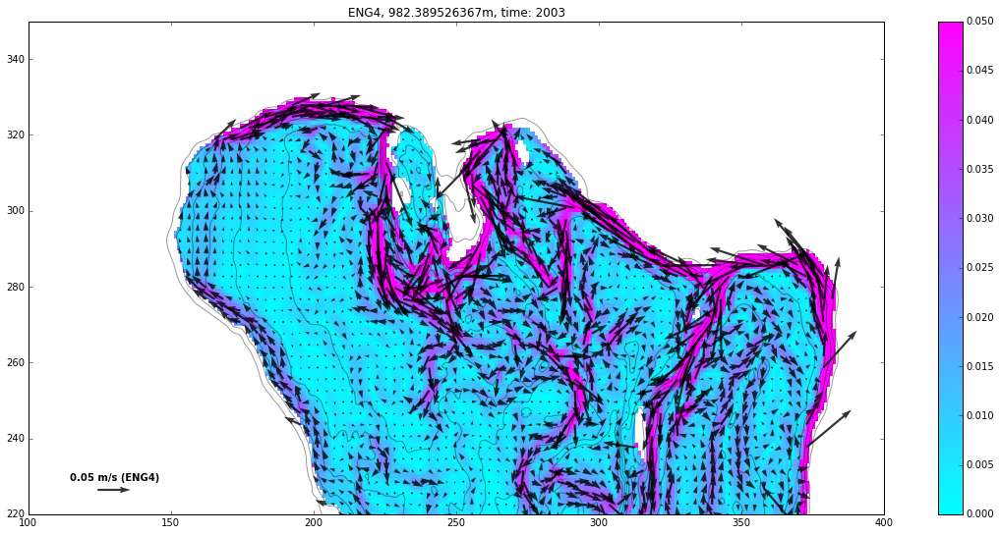

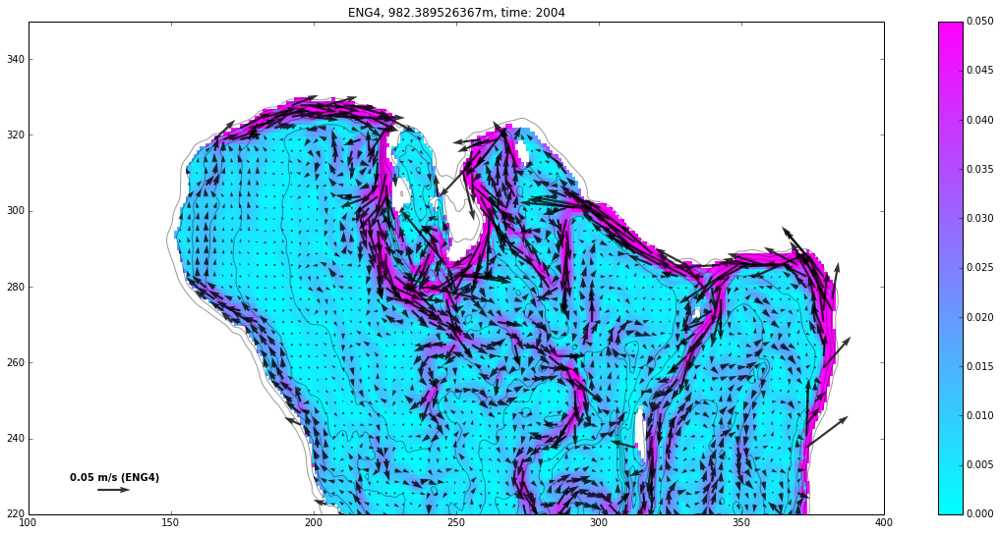

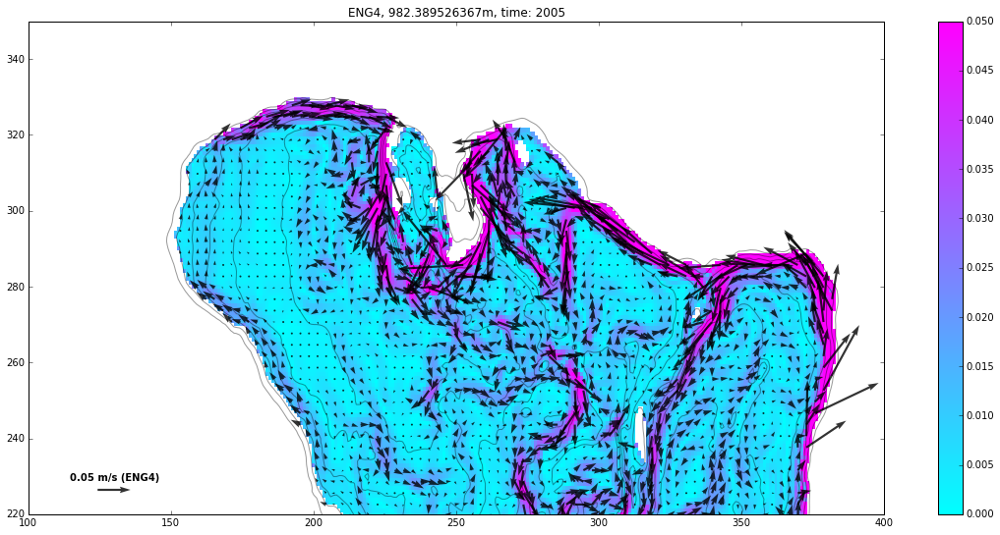

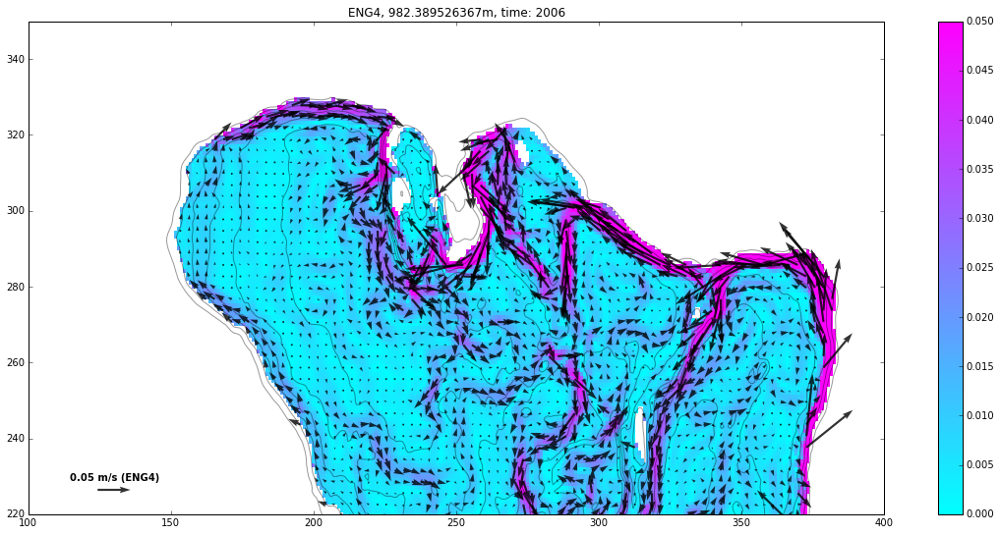

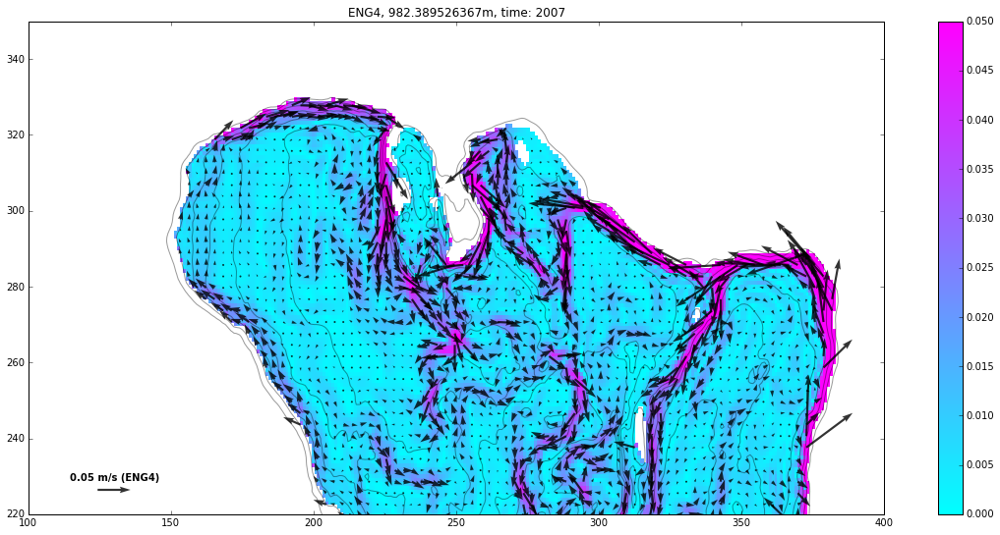

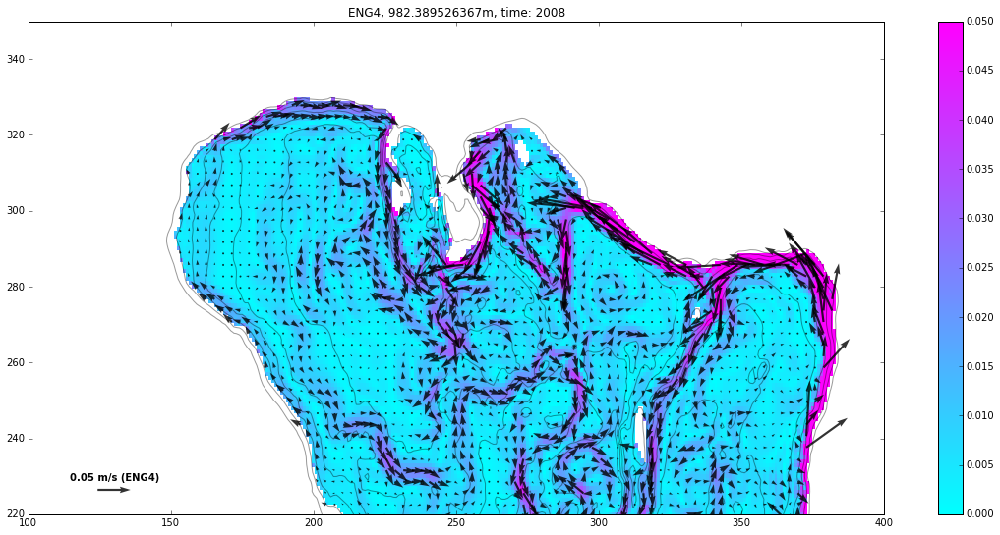

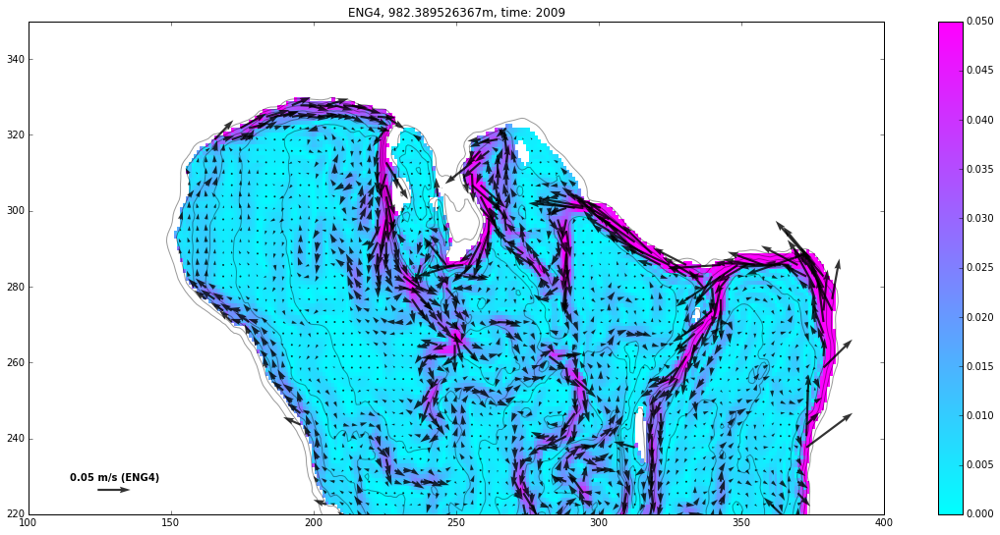

In [10]:
yearnum=8
fig = plt.figure(figsize=(18,8))
k=0
layer = 35
for i in range (yearnum):
    time =i
    
    x_lon,y_lat = lon,lat
    U =vel('U',time+2002,'ENG4')
    V =vel('V',time+2002,'ENG4')

    
    
    fig = plt.figure(figsize=(13*1.5,6*1.5))
    
    ax = fig.add_subplot(111)
    #velocity
    speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
    plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='cool',vmin=0,vmax=0.05);plt.colorbar()
    
    #mask too large value so that the vector plot can look good
    u =np.ma.masked_where(abs(V)>0.1,U)
    v =np.ma.masked_where(abs(V)>0.1,V)
    u =np.ma.masked_where(abs(U)>0.1,u)
    v =np.ma.masked_where(abs(U)>0.1,v)
    #vector
    Q=plt.quiver(x2d[::3,::3], y2d[::3,::3], u[layer,::3,::3], v[layer,::3,::3],
               scale=1.3,width=0.0025,color='k',alpha=0.8)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.05, '0.05 m/s (ENG4)',fontproperties={'weight': 'bold'})
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.ylim(220,350)    
    plt.xlim(100,400)
    
    
    plt.title('ENG4, %sm, time: %s'%((dep[layer]+dep[layer-1])/2,2002+i))
    k+=1

/home/xiaoxiny/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:424: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


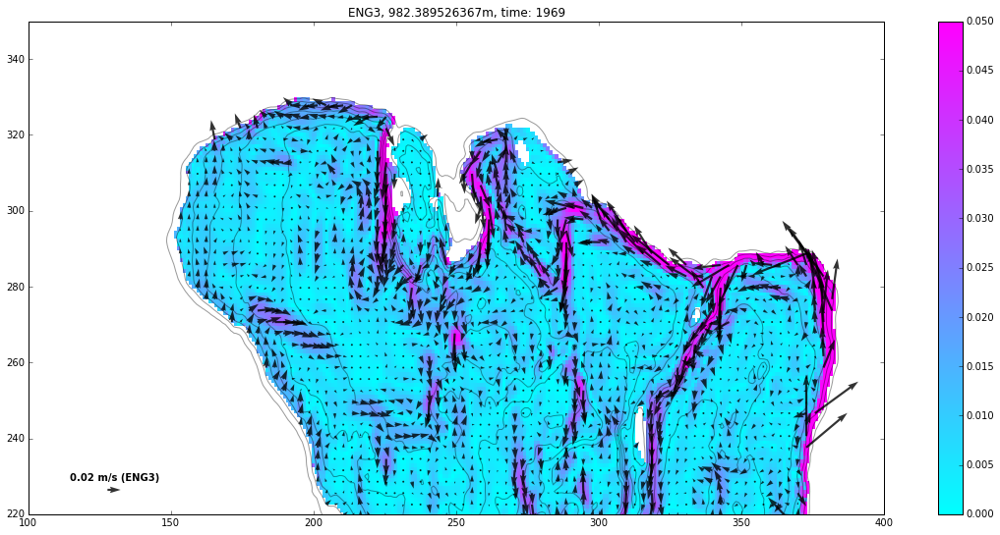

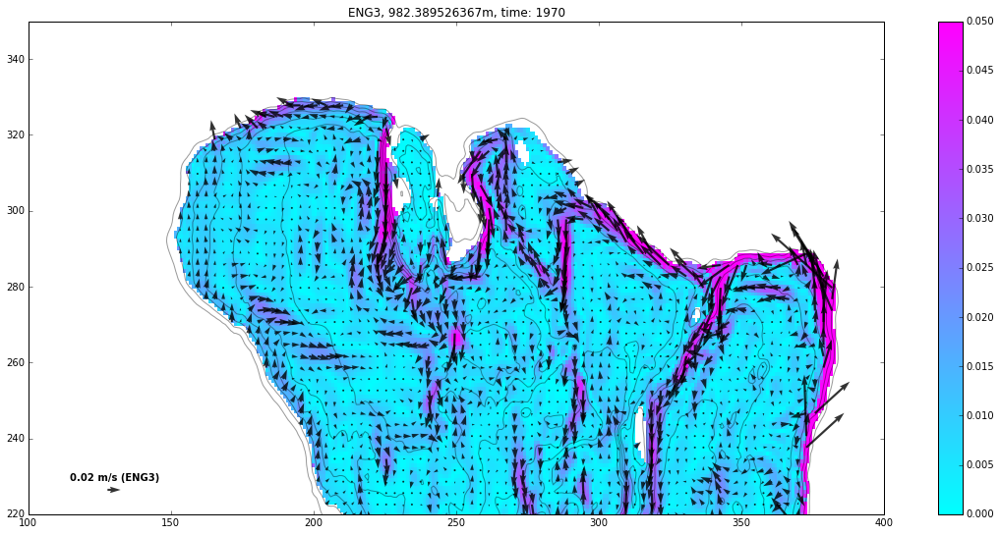

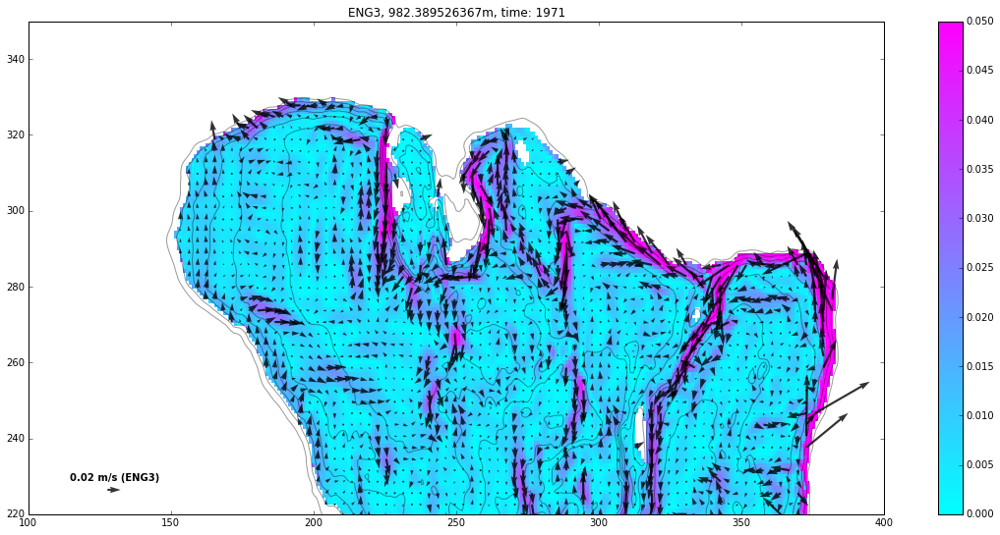

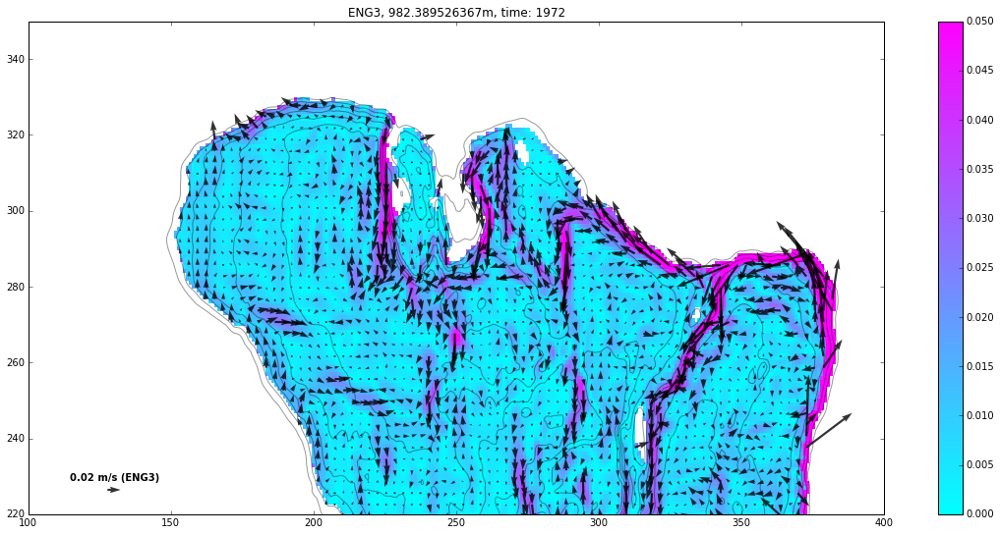

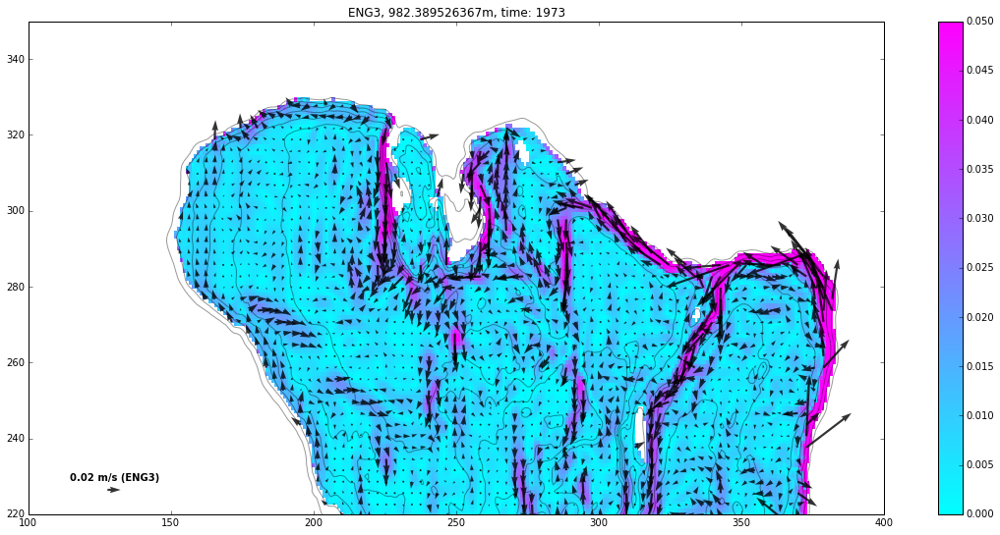

...

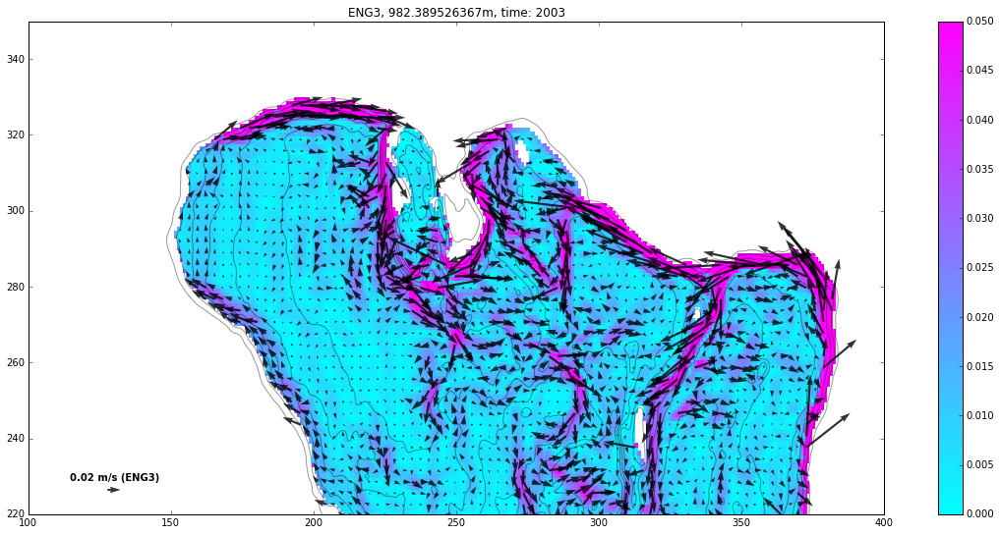

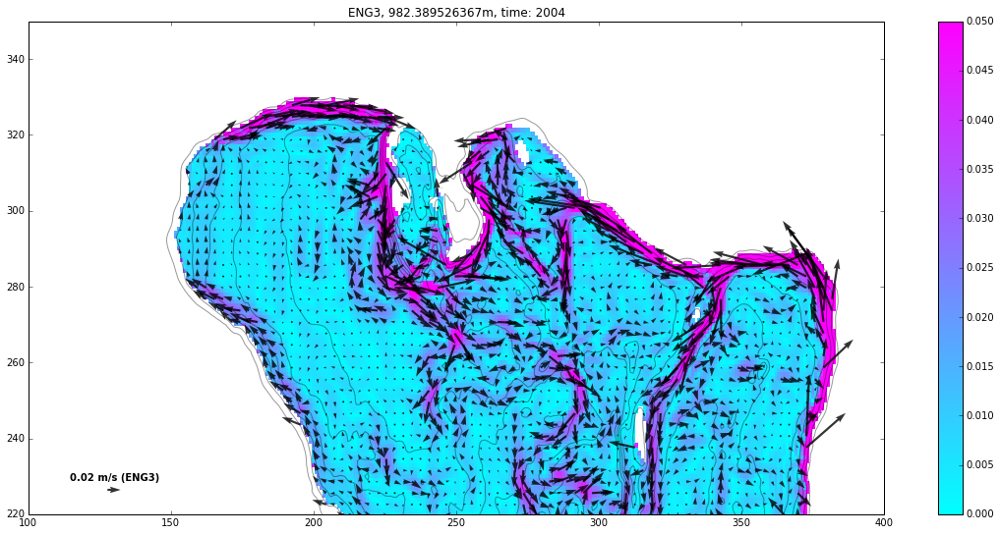

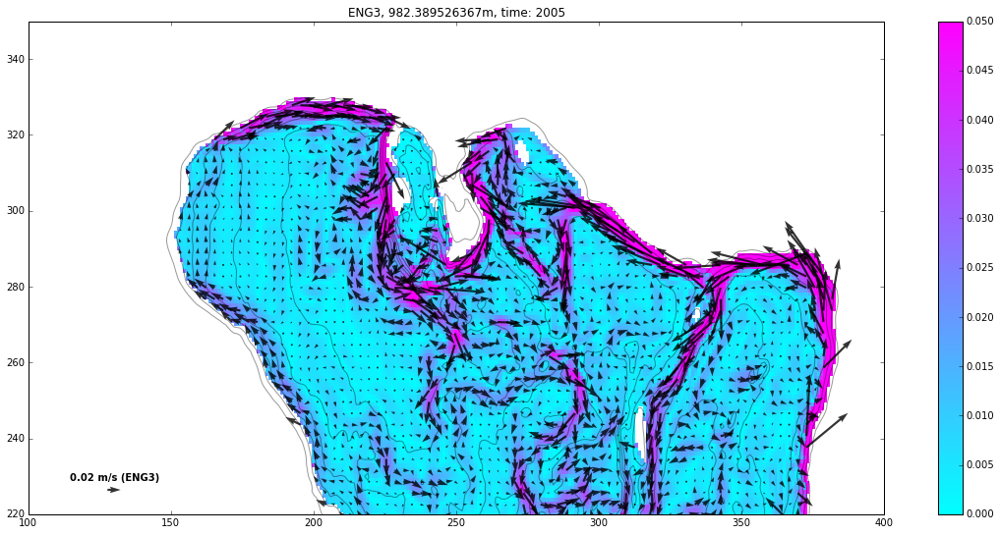

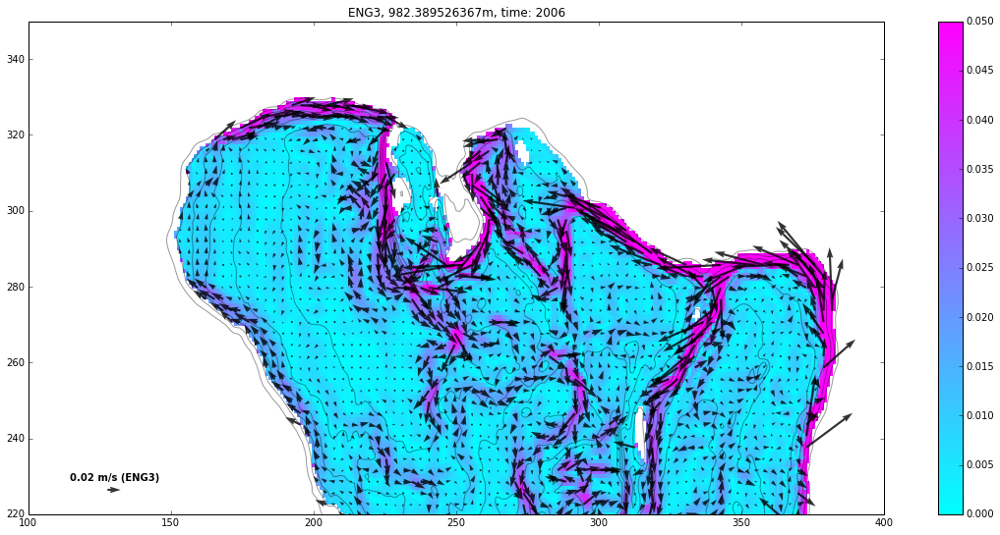

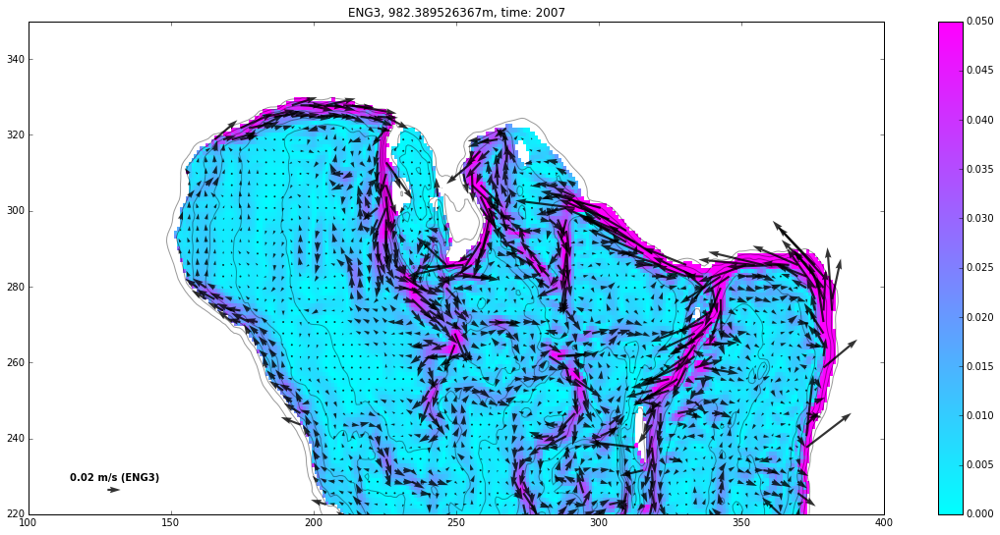

In [26]:
yearnum=39
fig = plt.figure(figsize=(18,8))
k=0
layer = 35
for i in range (yearnum):
    time =i
    
    x_lon,y_lat = lon,lat
    U =vel('U',time+1969,'ENG3')
    V =vel('V',time+1969,'ENG3')

    
    
    fig = plt.figure(figsize=(13*1.5,6*1.5))
    
    ax = fig.add_subplot(111)
    speed=(U[layer,:,:]**2+ V[layer,:,:]**2)**0.5
    plt.pcolor(x2d[:,:], y2d[:,:], speed[:,:],cmap='cool',vmin=0,vmax=0.05);plt.colorbar()
    
    #mask too large value
    u =np.ma.masked_where(abs(V)>0.1,U)
    v =np.ma.masked_where(abs(V)>0.1,V)
    u =np.ma.masked_where(abs(U)>0.1,u)
    v =np.ma.masked_where(abs(U)>0.1,v)
    Q=plt.quiver(x2d[::3,::3], y2d[::3,::3], u[layer,::3,::3], v[layer,::3,::3],
               scale=1.3,width=0.0025,color='k',alpha=0.8)
    Qlabel=plt.quiverkey(Q,0.1, 0.05, 0.02, '0.02 m/s (ENG3)',fontproperties={'weight': 'bold'})
    plt.contour(bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.ylim(220,350)    
    plt.xlim(100,400)
    
    
    plt.title('ENG3, %sm, time: %s'%((dep[layer]+dep[layer-1])/2,1969+i))
    k+=1